In [1]:
#Imports and library used

import pandas as pd
from tabulate import tabulate
from IPython.display import display, HTML
import io
import sys
import matplotlib.pyplot as plt
import seaborn as sns
from scipy.stats import f_oneway
import numpy as np
import plotly.express as px
from mpl_toolkits.mplot3d import Axes3D
from matplotlib.animation import FuncAnimation
from sklearn.preprocessing import LabelEncoder
import plotly.graph_objects as go
import statsmodels.api as sm
from statsmodels.formula.api import ols
from scipy.stats import linregress
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestRegressor
from sklearn.metrics import mean_squared_error, r2_score

In [ ]:
# Loading the dataset
df = pd.read_csv("cop_data.csv", index_col=0)

# Displaying the first 5 rows in a neat tabular format
print("First 5 rows of the dataset (Tabulate format):")

# Creating a table using the tabulate function
table = tabulate(df.head(), headers='keys', tablefmt='html', showindex=False)

# Using Custom CSS Styling for the Table
styled_table = f"""
<div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 16px; text-align: center; border: 1px solid #ddd;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold; text-align: center;">
            {table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_table))

First 5 rows of the dataset (Tabulate format):


cet_cest_timestamp,country,source,floor,radiator,water
2007-12-31T23:00:00+0100,AT,ASHP,2.8,2.24,2.03
2007-12-31T23:00:00+0100,AT,GSHP,3.72,2.77,2.4
2007-12-31T23:00:00+0100,AT,WSHP,4.57,3.32,2.8
2008-01-01T00:00:00+0100,AT,ASHP,2.8,2.24,2.03
2008-01-01T00:00:00+0100,AT,GSHP,3.72,2.77,2.4


In [ ]:
# Generating summary statistics
summary = df.describe()

# Creating a table using the tabulate function
summary_table = tabulate(summary, headers='keys', tablefmt='html')

# Using Custom CSS Styling for the Summary Table
styled_summary_table = f"""
<div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
    <table style="width: 100%; border-collapse: collapse; margin: 25px 0; font-size: 16px; text-align: center; border: 1px solid #ddd;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold; text-align: center;">
            {summary_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {summary_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled summary table in Jupyter Notebook
display(HTML(styled_summary_table))

,floor,radiator,water
count,1.10446e+07,1.10446e+07,1.10446e+07
mean,4.83175,4.36116,2.86844
std,1.01828,1.13537,0.472921
min,1.45,1.14,1.33
25%,4.05,3.57,2.64
50%,4.91,4.06,2.8
75%,5.73,5.28,2.99
max,6.34,6.34,5.87


In [ ]:
# Checking for missing values in the DataFrame
missing_values = df.isnull().sum().reset_index()
missing_values.columns = ['Column', 'Missing Values']

# Creating a table using the tabulate function
missing_table = tabulate(missing_values, headers='keys', tablefmt='html', showindex=False)

# Using Custom CSS Styling for the Missing Values Table (table centered inside div)
styled_missing_table = f"""
<div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px; text-align: center;">
    <table style="margin: 0 auto; width: 50%; border-collapse: collapse; margin-top: 25px; font-size: 16px; text-align: center; border: 1px solid #ddd;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {missing_table.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {missing_table.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled, centered missing values table in Jupyter Notebook
display(HTML(styled_missing_table))


Column,Missing Values
cet_cest_timestamp,0
country,0
source,0
floor,0
radiator,0
water,0


In [ ]:
# For Function to calculate summary statistics for each heating parameter
def calculate_summary(df, parameter):
    summary = df.groupby(['country', 'source'])[parameter].agg(['mean', 'std', 'min', 'max']).reset_index()
    return summary

# Generating summary statistics for each heating parameter
floor_summary = calculate_summary(df, 'floor')
radiator_summary = calculate_summary(df, 'radiator')
water_summary = calculate_summary(df, 'water')

# Using ANOVA for Floor heating
floor_asph = df[df['source'] == 'ASHP']['floor']
floor_gsph = df[df['source'] == 'GSHP']['floor']
floor_wsph = df[df['source'] == 'WSHP']['floor']
f_stat_floor, p_value_floor = f_oneway(floor_asph, floor_gsph, floor_wsph)

# Using ANOVA for Radiator heating
radiator_asph = df[df['source'] == 'ASHP']['radiator']
radiator_gsph = df[df['source'] == 'GSHP']['radiator']
radiator_wsph = df[df['source'] == 'WSHP']['radiator']
f_stat_radiator, p_value_radiator = f_oneway(radiator_asph, radiator_gsph, radiator_wsph)

# Using ANOVA for Water heating
water_asph = df[df['source'] == 'ASHP']['water']
water_gsph = df[df['source'] == 'GSHP']['water']
water_wsph = df[df['source'] == 'WSHP']['water']
f_stat_water, p_value_water = f_oneway(water_asph, water_gsph, water_wsph)

# Adding ANOVA results to summaries
floor_summary['F-statistic'] = f_stat_floor
floor_summary['p-value'] = p_value_floor
radiator_summary['F-statistic'] = f_stat_radiator
radiator_summary['p-value'] = p_value_radiator
water_summary['F-statistic'] = f_stat_water
water_summary['p-value'] = p_value_water

# Combining the summaries into one table
combined_summary = pd.concat([floor_summary[['country', 'source', 'mean', 'std', 'min', 'max', 'F-statistic', 'p-value']].assign(Parameter='Floor'),
                              radiator_summary[['country', 'source', 'mean', 'std', 'min', 'max', 'F-statistic', 'p-value']].assign(Parameter='Radiator'),
                              water_summary[['country', 'source', 'mean', 'std', 'min', 'max', 'F-statistic', 'p-value']].assign(Parameter='Water')],
                             ignore_index=True)

# Converting combined_summary to HTML for styling
table_html = tabulate(combined_summary.head(30), headers='keys', tablefmt='html', showindex=False)

# Using Custom CSS Styling for the Summary Table
styled_table = f"""
<div style="font-family: Arial, sans-serif; background-color: #f4f4f9; padding: 30px; border-radius: 10px; text-align: center;">
    <table style="width: 80%; margin: 0 auto; border-collapse: collapse; font-size: 14px; text-align: center; border: 1px solid #ddd; background-color: #fff;">
        <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
            {table_html.split('<thead>')[1].split('</thead>')[0]}
        </thead>
        <tbody style="background-color: #ffffff;">
            {table_html.split('<tbody>')[1].split('</tbody>')[0]}
        </tbody>
    </table>
</div>
"""

# Displaying the styled table in Jupyter Notebook
display(HTML(styled_table))

country,source,mean,std,min,max,F-statistic,p-value,Parameter
AT,ASHP,3.61771,0.445832,1.96,4.06,7.73575e+06,0,Floor
AT,GSHP,5.07422,0.908662,2.64,6.34,7.73575e+06,0,Floor
AT,WSHP,5.27309,0.453023,3.87,6.12,7.73575e+06,0,Floor
BE,ASHP,3.82965,0.328939,2.15,4.06,7.73575e+06,0,Floor
BE,GSHP,5.55938,0.822025,2.66,6.34,7.73575e+06,0,Floor
BE,WSHP,5.477,0.409515,4.04,6.12,7.73575e+06,0,Floor
BG,ASHP,3.73253,0.43524,1.75,4.06,7.73575e+06,0,Floor
BG,GSHP,5.38357,0.968642,2.63,6.34,7.73575e+06,0,Floor
BG,WSHP,5.43545,0.504106,3.66,6.12,7.73575e+06,0,Floor
CH,ASHP,3.59009,0.439013,1.87,4.06,7.73575e+06,0,Floor


C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:7: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='source', y='floor', data=df, ax=axes[0], palette="Set3")
C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:11: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='source', y='radiator', data=df, ax=axes[1], palette="Set3")
C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:15: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.boxplot(x='source', y='water', data=df, ax=axes[2], palette="Set3")


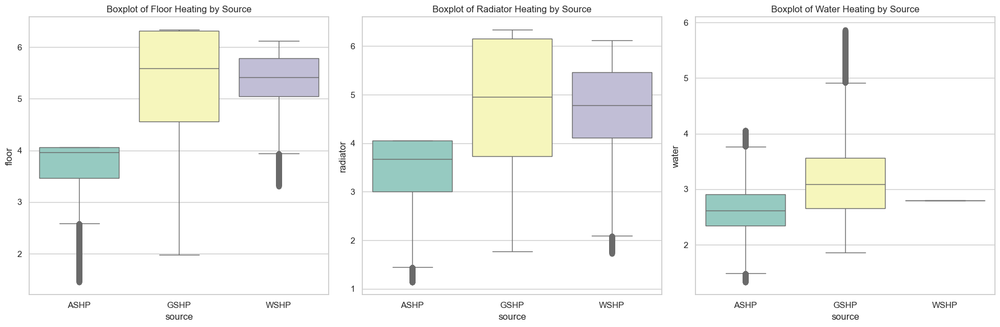

C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:26: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='source', y='floor', data=df, ax=axes[0], palette="Set2")
C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:30: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='source', y='radiator', data=df, ax=axes[1], palette="Set2")
C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:34: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.barplot(x='source', y='water', data=df, ax=axes[2], palette="Set2")


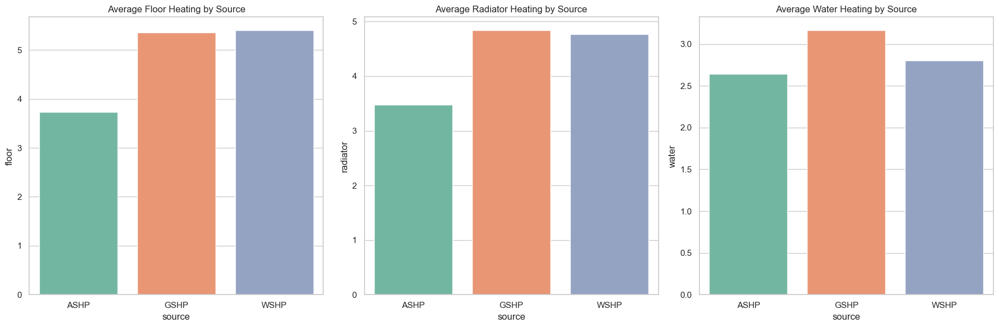

C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:45: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='source', y='floor', data=df, ax=axes[0], palette="muted")
C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:49: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='source', y='radiator', data=df, ax=axes[1], palette="muted")
C:\Users\oppor\AppData\Local\Temp\ipykernel_16544\93109880.py:53: FutureWarning: 

Passing `palette` without assigning `hue` is deprecated and will be removed in v0.14.0. Assign the `x` variable to `hue` and set `legend=False` for the same effect.

  sns.violinplot(x='source', y='water', data=df, ax=axes[2], palette="muted")


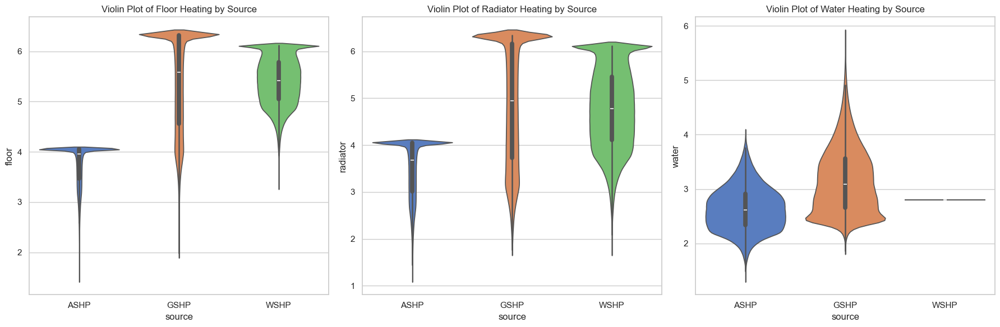

In [ ]:
sns.set(style="whitegrid")

# Creating a figure for multiple subplots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Using Boxplot for Floor heating
sns.boxplot(x='source', y='floor', data=df, ax=axes[0], palette="Set3")
axes[0].set_title('Boxplot of Floor Heating by Source')

# Using Boxplot for Radiator heating
sns.boxplot(x='source', y='radiator', data=df, ax=axes[1], palette="Set3")
axes[1].set_title('Boxplot of Radiator Heating by Source')

# Using Boxplot for Water heating
sns.boxplot(x='source', y='water', data=df, ax=axes[2], palette="Set3")
axes[2].set_title('Boxplot of Water Heating by Source')

# Adjusting layout for better spacing
plt.tight_layout()
plt.show()

# Creating a new figure for bar plots of mean values
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Using Bar plot for Floor heating (mean comparison)
sns.barplot(x='source', y='floor', data=df, ax=axes[0], palette="Set2")
axes[0].set_title('Average Floor Heating by Source')

# Using Bar plot for Radiator heating (mean comparison)
sns.barplot(x='source', y='radiator', data=df, ax=axes[1], palette="Set2")
axes[1].set_title('Average Radiator Heating by Source')

# Using Bar plot for Water heating (mean comparison)
sns.barplot(x='source', y='water', data=df, ax=axes[2], palette="Set2")
axes[2].set_title('Average Water Heating by Source')

# Adjusting layout for better spacing
plt.tight_layout()
plt.show()

# Creating a new figure for violin plots
fig, axes = plt.subplots(1, 3, figsize=(18, 6))

# Using Violin plot for Floor heating
sns.violinplot(x='source', y='floor', data=df, ax=axes[0], palette="muted")
axes[0].set_title('Violin Plot of Floor Heating by Source')

# Using Violin plot for Radiator heating
sns.violinplot(x='source', y='radiator', data=df, ax=axes[1], palette="muted")
axes[1].set_title('Violin Plot of Radiator Heating by Source')

# Using Violin plot for Water heating
sns.violinplot(x='source', y='water', data=df, ax=axes[2], palette="muted")
axes[2].set_title('Violin Plot of Water Heating by Source')

# Adjusting layout for better spacing
plt.tight_layout()
plt.show()

In [ ]:
# Converting timestamp to datetime and extract hour
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['hour'] = df['cet_cest_timestamp'].dt.hour

# For Group by country, hour, and source — compute water statistics
water_summary = df.groupby(['country', 'hour', 'source']).agg(
    Water_Mean=('water', 'mean'),
    Water_Std=('water', 'std'),
    Water_Min=('water', 'min'),
    Water_Median=('water', 'median'),
    Water_25=('water', lambda x: x.quantile(0.25)),
    Water_75=('water', lambda x: x.quantile(0.75)),
    Water_Max=('water', 'max')
).reset_index()

# Rendering clean styled HTML table with separator line between hours and country shown at the second row
def render_water_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Hour</th>
                    <th>Source</th>
                    <th>Water Mean</th>
                    <th>Water Std</th>
                    <th>Water Min</th>
                    <th>Water Median</th>
                    <th>Water 25%</th>
                    <th>Water 75%</th>
                    <th>Water Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """
    
    last_hour = None
    for _, row in df.iterrows():
        # Adding a separator row when the hour changes
        if last_hour is not None and row['hour'] != last_hour:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'
        
        # Displaying country only on the second row of each hour group
        country_display = ""  # Empty country value for the first row of each hour group
        if row['hour'] != last_hour:
            country_display = row['country']  # Show country only on the second row of each hour group

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{int(row['hour'])}</td>
            <td>{row['source']}</td>
            <td>{row['Water_Mean']:.3f}</td>
            <td>{row['Water_Std']:.4f}</td>
            <td>{row['Water_Min']}</td>
            <td>{row['Water_Median']}</td>
            <td>{row['Water_25']}</td>
            <td>{row['Water_75']}</td>
            <td>{row['Water_Max']}</td>
        </tr>
        """
        last_hour = row['hour']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html

# Assuming `water_summary` dataframe is already available
styled_water_summary_table = render_water_summary_table(water_summary)
display(HTML(styled_water_summary_table))

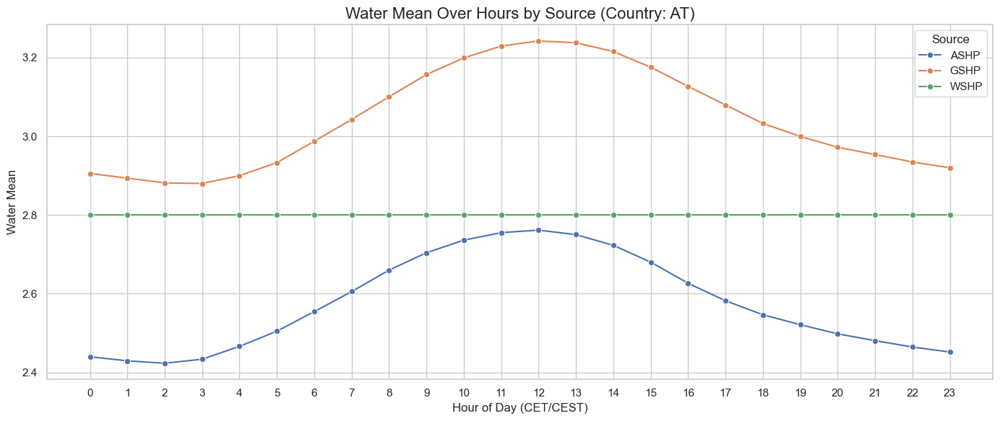

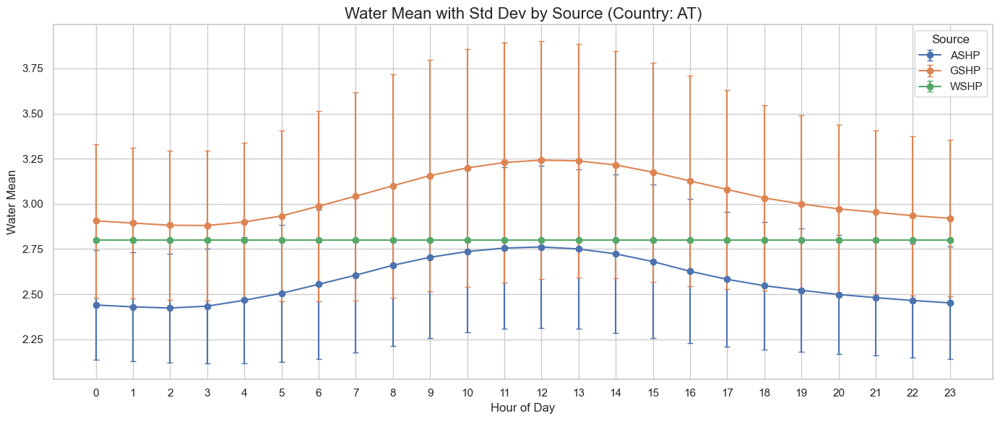

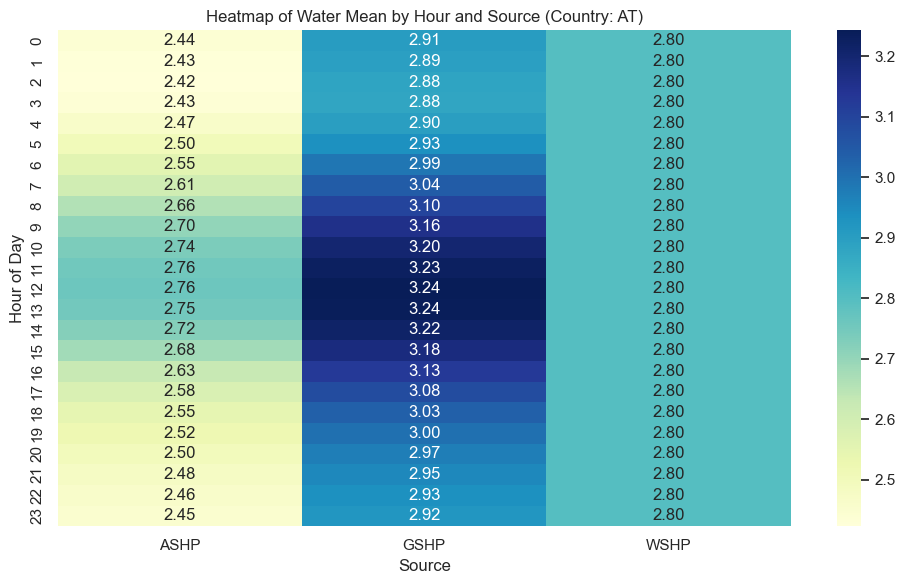

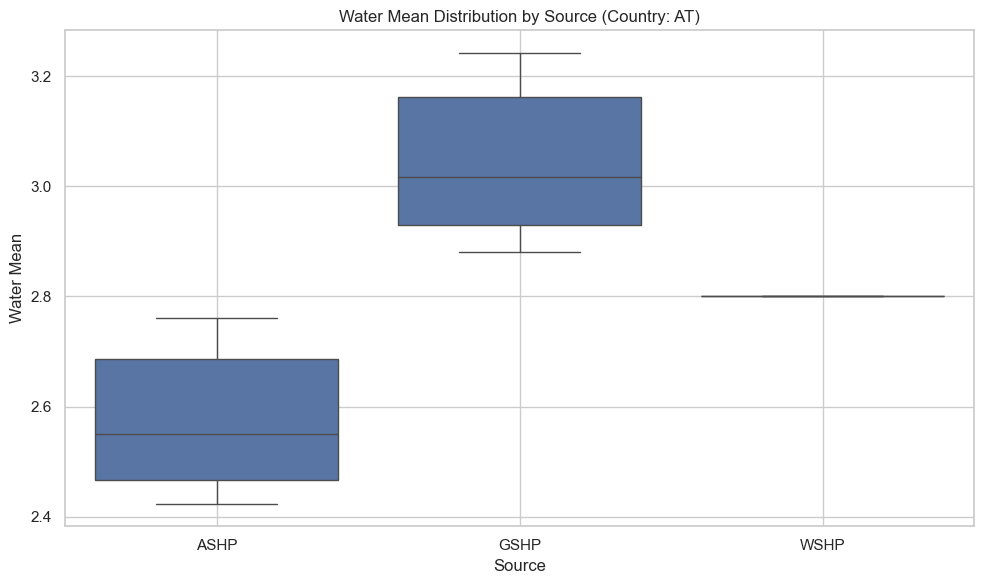

In [ ]:
country_filter = 'AT'
df_plot = water_summary[water_summary['country'] == country_filter]

# Setting Seaborn theme
sns.set_theme(style="whitegrid")

# Creating a line plot of Water Mean vs Hour, with a line for each Source
plt.figure(figsize=(14, 6))
sns.lineplot(
    data=df_plot,
    x='hour',
    y='Water_Mean',
    hue='source',
    marker='o'
)

plt.title(f'Water Mean Over Hours by Source (Country: {country_filter})', fontsize=16)
plt.xlabel('Hour of Day (CET/CEST)', fontsize=12)
plt.ylabel('Water Mean', fontsize=12)
plt.xticks(range(0, 24))
plt.legend(title='Source')
plt.grid(True)
plt.tight_layout()
plt.show()



plt.figure(figsize=(14, 6))

for source in df_plot['source'].unique():
    data_source = df_plot[df_plot['source'] == source]
    plt.errorbar(
        data_source['hour'],
        data_source['Water_Mean'],
        yerr=data_source['Water_Std'],
        label=source,
        marker='o',
        capsize=3
    )

plt.title(f'Water Mean with Std Dev by Source (Country: {country_filter})', fontsize=16)
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('Water Mean', fontsize=12)
plt.legend(title='Source')
plt.xticks(range(0, 24))
plt.grid(True)
plt.tight_layout()
plt.show()



pivot_df = water_summary[water_summary['country'] == country_filter].pivot(
    index='hour',
    columns='source',
    values='Water_Mean'
)

plt.figure(figsize=(10, 6))
sns.heatmap(pivot_df, annot=True, fmt=".2f", cmap="YlGnBu")
plt.title(f'Heatmap of Water Mean by Hour and Source (Country: {country_filter})')
plt.ylabel('Hour of Day')
plt.xlabel('Source')
plt.tight_layout()
plt.show()




plt.figure(figsize=(10, 6))
sns.boxplot(
    data=water_summary[water_summary['country'] == country_filter],
    x='source',
    y='Water_Mean'
)
plt.title(f'Water Mean Distribution by Source (Country: {country_filter})')
plt.xlabel('Source')
plt.ylabel('Water Mean')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
# Converting timestamp to datetime and extract ISO week
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['iso_week'] = df['cet_cest_timestamp'].dt.isocalendar().week

# Grouping by country, week (ignoring year), and source — compute water statistics
weekly_water_summary = df.groupby(['country', 'iso_week', 'source']).agg(
    Water_Mean=('water', 'mean'),
    Water_Std=('water', 'std'),
    Water_Min=('water', 'min'),
    Water_Median=('water', 'median'),
    Water_25=('water', lambda x: x.quantile(0.25)),
    Water_75=('water', lambda x: x.quantile(0.75)),
    Water_Max=('water', 'max')
).reset_index()


def render_weekly_water_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Week</th>
                    <th>Source</th>
                    <th>Water Mean</th>
                    <th>Water Std</th>
                    <th>Water Min</th>
                    <th>Water Median</th>
                    <th>Water 25%</th>
                    <th>Water 75%</th>
                    <th>Water Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_week = None
    for _, row in df.iterrows():
        # Adding a separator row when the week changes
        if last_week is not None and row['iso_week'] != last_week:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each week group
        country_display = ""  
        if row['iso_week'] != last_week:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{row['iso_week']}</td>
            <td>{row['source']}</td>
            <td>{row['Water_Mean']:.3f}</td>
            <td>{row['Water_Std']:.4f}</td>
            <td>{row['Water_Min']}</td>
            <td>{row['Water_Median']}</td>
            <td>{row['Water_25']}</td>
            <td>{row['Water_75']}</td>
            <td>{row['Water_Max']}</td>
        </tr>
        """
        last_week = row['iso_week']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html



styled_weekly_summary_table = render_weekly_water_summary_table(weekly_water_summary)
display(HTML(styled_weekly_summary_table))


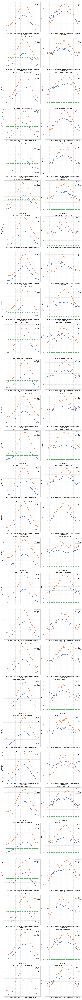

In [ ]:
# Assuming your weekly_water_summary dataframe is called `weekly_water_summary`
countries = weekly_water_summary['country'].unique()

# Setting style
sns.set(style="whitegrid")

# Using Number of subplots (one per country)
n_countries = len(countries)

# Creating a figure with subplots: 2 rows, number of countries columns
fig, axes = plt.subplots(n_countries, 2, figsize=(14, 6 * n_countries))

# If only one country, axes will be a single 1D array, so we need to handle that
if n_countries == 1:
    axes = axes.reshape(1, 2)

# Looping over each country to create a subplot
for i, country in enumerate(countries):
    country_data = weekly_water_summary[weekly_water_summary['country'] == country]
    
    # Ploting Water Mean (left column)
    sns.lineplot(data=country_data, x='iso_week', y='Water_Mean', hue='source', marker='o', ax=axes[i, 0])
    axes[i, 0].set_title(f'Weekly Water Mean by Source ({country})', fontsize=14)
    axes[i, 0].set_xlabel('ISO Week Number')
    axes[i, 0].set_ylabel('Water Mean')
    axes[i, 0].set_xticks(range(1, 53))  # one tick per week
    axes[i, 0].grid(True, linestyle='--', alpha=0.5)
    axes[i, 0].legend(title='Source')

    # Ploting Water Std (right column)
    sns.lineplot(data=country_data, x='iso_week', y='Water_Std', hue='source', marker='o', ax=axes[i, 1])
    axes[i, 1].set_title(f'Weekly Water Std by Source ({country})', fontsize=14)
    axes[i, 1].set_xlabel('ISO Week Number')
    axes[i, 1].set_ylabel('Water Std')
    axes[i, 1].set_xticks(range(1, 53))  # one tick per week
    axes[i, 1].grid(True, linestyle='--', alpha=0.5)
    axes[i, 1].legend(title='Source')

# Adjusting layout to prevent overlapping
plt.tight_layout()
plt.show()

In [ ]:
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['month'] = df['cet_cest_timestamp'].dt.month

# Grouping by country, month, and source — compute water statistics
monthly_water_summary = df.groupby(['country', 'month', 'source']).agg(
    Water_Mean=('water', 'mean'),
    Water_Std=('water', 'std'),
    Water_Min=('water', 'min'),
    Water_Median=('water', 'median'),
    Water_25=('water', lambda x: x.quantile(0.25)),
    Water_75=('water', lambda x: x.quantile(0.75)),
    Water_Max=('water', 'max')
).reset_index()

def render_monthly_water_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Month</th>
                    <th>Source</th>
                    <th>Water Mean</th>
                    <th>Water Std</th>
                    <th>Water Min</th>
                    <th>Water Median</th>
                    <th>Water 25%</th>
                    <th>Water 75%</th>
                    <th>Water Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_month = None
    for _, row in df.iterrows():
        # Adding a separator row when the month changes
        if last_month is not None and row['month'] != last_month:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each month group
        country_display = ""  
        if row['month'] != last_month:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{row['month']}</td>
            <td>{row['source']}</td>
            <td>{row['Water_Mean']:.3f}</td>
            <td>{row['Water_Std']:.4f}</td>
            <td>{row['Water_Min']}</td>
            <td>{row['Water_Median']}</td>
            <td>{row['Water_25']}</td>
            <td>{row['Water_75']}</td>
            <td>{row['Water_Max']}</td>
        </tr>
        """
        last_month = row['month']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html


# Assuming `monthly_water_summary` dataframe is already available
styled_monthly_summary_table = render_monthly_water_summary_table(monthly_water_summary)
display(HTML(styled_monthly_summary_table))

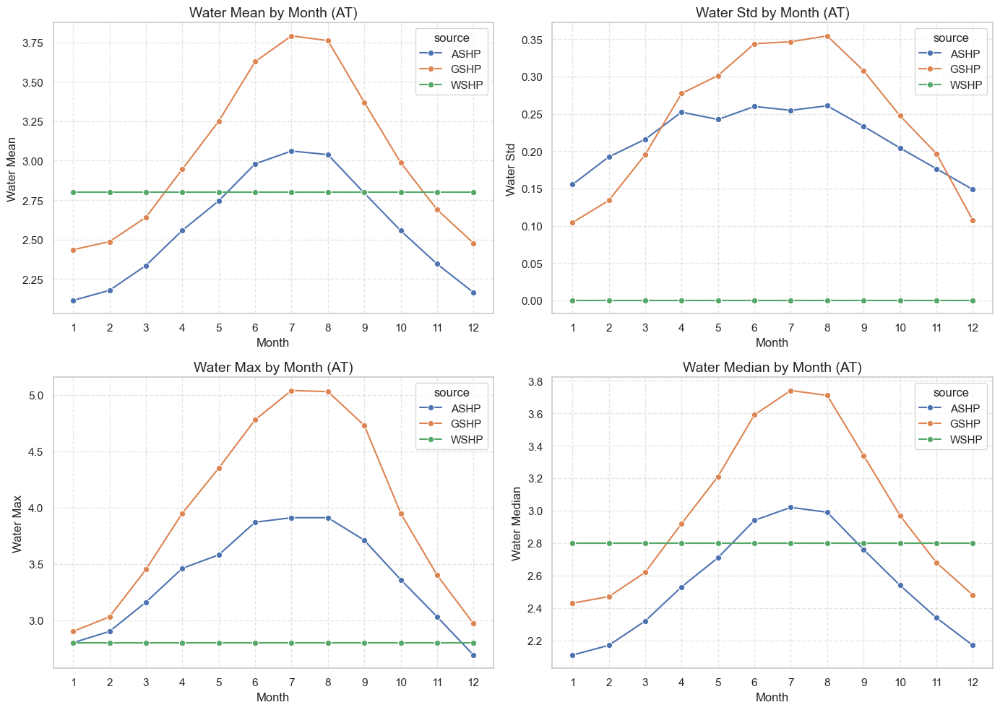

In [ ]:
at_monthly = monthly_water_summary[monthly_water_summary['country'] == 'AT']

# Setting the style for plots
sns.set(style="whitegrid")

# Creating a figure with multiple subplots for each metric (Water Mean, Water Std, Water Max)
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# Ploting Water Mean over Month
sns.lineplot(data=at_monthly, x='month', y='Water_Mean', hue='source', marker='o', ax=axs[0, 0])
axs[0, 0].set_title('Water Mean by Month (AT)', fontsize=14)
axs[0, 0].set_xlabel('Month')
axs[0, 0].set_ylabel('Water Mean')
axs[0, 0].set_xticks(range(1, 13))  # Months 1 to 12
axs[0, 0].grid(True, linestyle='--', alpha=0.5)

# Ploting Water Std over Month
sns.lineplot(data=at_monthly, x='month', y='Water_Std', hue='source', marker='o', ax=axs[0, 1])
axs[0, 1].set_title('Water Std by Month (AT)', fontsize=14)
axs[0, 1].set_xlabel('Month')
axs[0, 1].set_ylabel('Water Std')
axs[0, 1].set_xticks(range(1, 13))  # Months 1 to 12
axs[0, 1].grid(True, linestyle='--', alpha=0.5)

# Ploting Water Max over Month
sns.lineplot(data=at_monthly, x='month', y='Water_Max', hue='source', marker='o', ax=axs[1, 0])
axs[1, 0].set_title('Water Max by Month (AT)', fontsize=14)
axs[1, 0].set_xlabel('Month')
axs[1, 0].set_ylabel('Water Max')
axs[1, 0].set_xticks(range(1, 13))  # Months 1 to 12
axs[1, 0].grid(True, linestyle='--', alpha=0.5)

# Ploting Water Median over Month
sns.lineplot(data=at_monthly, x='month', y='Water_Median', hue='source', marker='o', ax=axs[1, 1])
axs[1, 1].set_title('Water Median by Month (AT)', fontsize=14)
axs[1, 1].set_xlabel('Month')
axs[1, 1].set_ylabel('Water Median')
axs[1, 1].set_xticks(range(1, 13))  # Months 1 to 12
axs[1, 1].grid(True, linestyle='--', alpha=0.5)

# Adjusting layout to avoid overlap
plt.tight_layout()
plt.show()

In [ ]:
# Extracting Year from the timestamp
df['year'] = df['cet_cest_timestamp'].dt.year

# Grouping by country, year, and source — compute water statistics
yearly_water_summary = df.groupby(['country', 'year', 'source']).agg(
    Water_Mean=('water', 'mean'),
    Water_Std=('water', 'std'),
    Water_Min=('water', 'min'),
    Water_Median=('water', 'median'),
    Water_25=('water', lambda x: x.quantile(0.25)),
    Water_75=('water', lambda x: x.quantile(0.75)),
    Water_Max=('water', 'max')
).reset_index()

# Rendering a styled HTML table for yearly summary
def render_yearly_water_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Year</th>
                    <th>Source</th>
                    <th>Water Mean</th>
                    <th>Water Std</th>
                    <th>Water Min</th>
                    <th>Water Median</th>
                    <th>Water 25%</th>
                    <th>Water 75%</th>
                    <th>Water Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_year = None
    for _, row in df.iterrows():
        # Adding a separator row when the year changes
        if last_year is not None and row['year'] != last_year:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each year group
        country_display = ""  
        if row['year'] != last_year:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{row['year']}</td>
            <td>{row['source']}</td>
            <td>{row['Water_Mean']:.3f}</td>
            <td>{row['Water_Std']:.4f}</td>
            <td>{row['Water_Min']}</td>
            <td>{row['Water_Median']}</td>
            <td>{row['Water_25']}</td>
            <td>{row['Water_75']}</td>
            <td>{row['Water_Max']}</td>
        </tr>
        """
        last_year = row['year']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html

# Assuming `yearly_water_summary` dataframe is already available
styled_yearly_summary_table = render_yearly_water_summary_table(yearly_water_summary.head())
display(HTML(styled_yearly_summary_table))


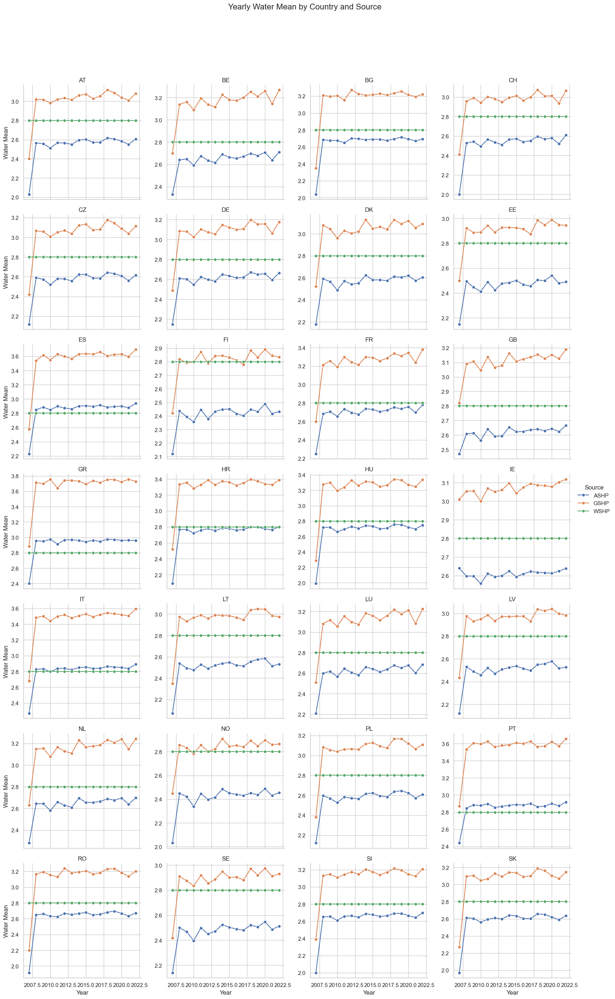

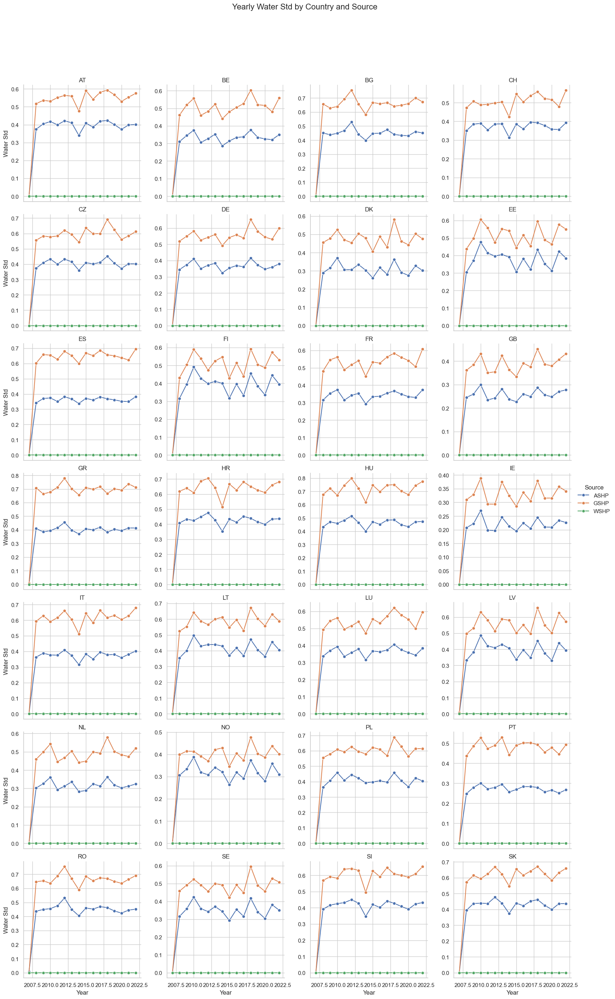

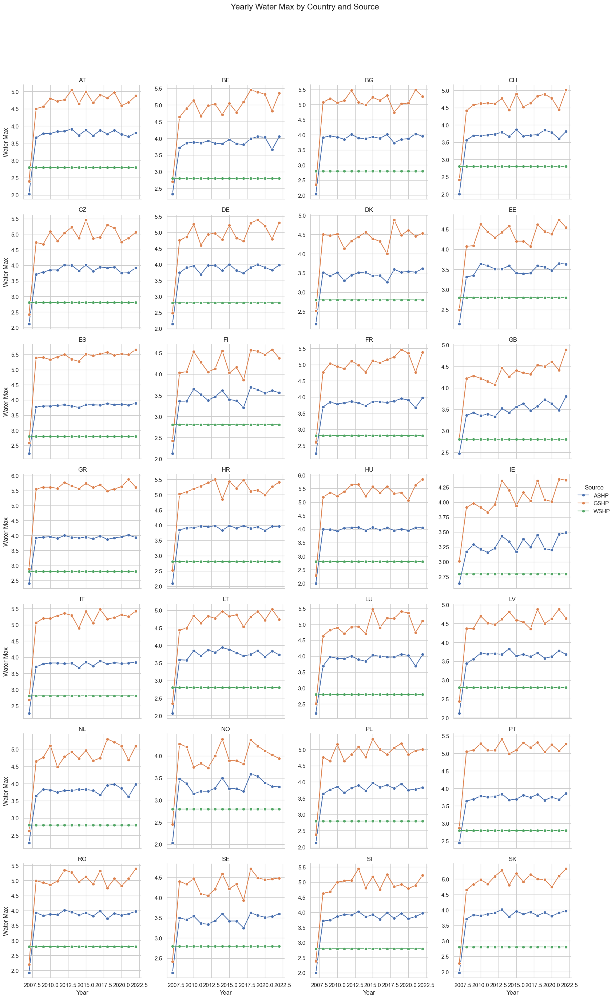

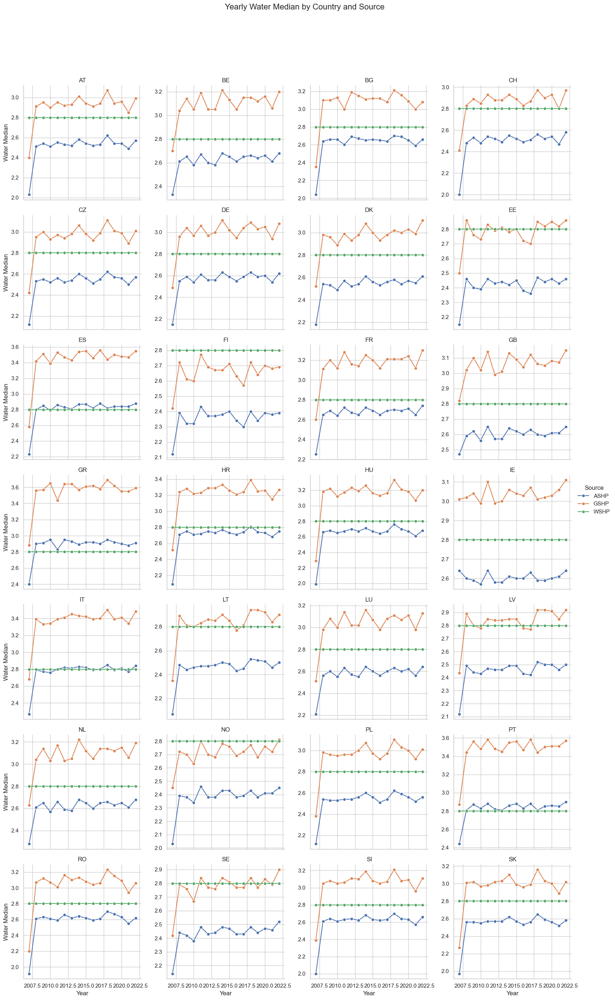

In [ ]:
# Setting up the FacetGrid for yearly data
g = sns.FacetGrid(yearly_water_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Water Mean, Water Std, Water Max)
g.map_dataframe(sns.lineplot, x="year", y="Water_Mean", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Water Mean")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Water Mean by Country and Source", fontsize=16)

plt.show()

# Setting up the FacetGrid for Water Std
g = sns.FacetGrid(yearly_water_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Water Std)
g.map_dataframe(sns.lineplot, x="year", y="Water_Std", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Water Std")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Water Std by Country and Source", fontsize=16)

plt.show()

# Setting up the FacetGrid for Water Max
g = sns.FacetGrid(yearly_water_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Water Max)
g.map_dataframe(sns.lineplot, x="year", y="Water_Max", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Water Max")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Water Max by Country and Source", fontsize=16)

plt.show()

# Setting up the FacetGrid for Water Median
g = sns.FacetGrid(yearly_water_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Water Median)
g.map_dataframe(sns.lineplot, x="year", y="Water_Median", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Water Median")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Water Median by Country and Source", fontsize=16)

plt.show()


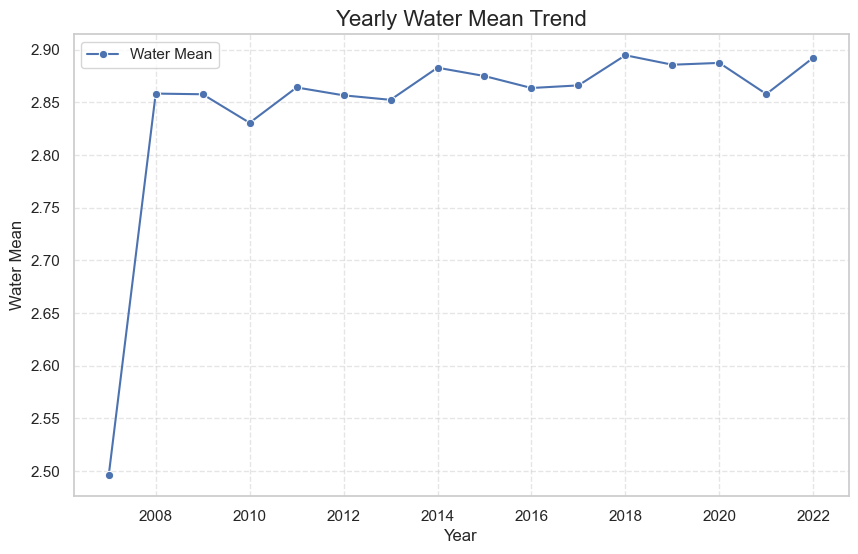

In [ ]:
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['year'] = df['cet_cest_timestamp'].dt.year

# Step 2: Grouping the data by year and calculate mean water usage for each year
yearly_water_trend = df.groupby('year').agg(
    Water_Mean=('water', 'mean'),
    Water_Std=('water', 'std'),
    Water_Min=('water', 'min'),
    Water_Median=('water', 'median'),
    Water_Max=('water', 'max')
).reset_index()

# Step 3: Ploting the yearly water trend (Water Mean)
plt.figure(figsize=(10, 6))
sns.lineplot(data=yearly_water_trend, x='year', y='Water_Mean', marker='o', label='Water Mean')

# Adding titles and labels
plt.title('Yearly Water Mean Trend', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Water Mean', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)

# Showing plot
plt.show()

In [ ]:
# Converting timestamp to datetime and extract hour
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['hour'] = df['cet_cest_timestamp'].dt.hour

# Grouping by country, hour, and source — compute radiator statistics
radiator_summary = df.groupby(['country', 'hour', 'source']).agg(
    Radiator_Mean=('radiator', 'mean'),
    Radiator_Std=('radiator', 'std'),
    Radiator_Min=('radiator', 'min'),
    Radiator_Median=('radiator', 'median'),
    Radiator_25=('radiator', lambda x: x.quantile(0.25)),
    Radiator_75=('radiator', lambda x: x.quantile(0.75)),
    Radiator_Max=('radiator', 'max')
).reset_index()

def render_radiator_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Hour</th>
                    <th>Source</th>
                    <th>Radiator Mean</th>
                    <th>Radiator Std</th>
                    <th>Radiator Min</th>
                    <th>Radiator Median</th>
                    <th>Radiator 25%</th>
                    <th>Radiator 75%</th>
                    <th>Radiator Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_hour = None
    for _, row in df.iterrows():
        # Adding a separator row when the hour changes
        if last_hour is not None and row['hour'] != last_hour:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each hour group
        country_display = ""  
        if row['hour'] != last_hour:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{int(row['hour'])}</td>
            <td>{row['source']}</td>
            <td>{row['Radiator_Mean']:.3f}</td>
            <td>{row['Radiator_Std']:.4f}</td>
            <td>{row['Radiator_Min']}</td>
            <td>{row['Radiator_Median']}</td>
            <td>{row['Radiator_25']}</td>
            <td>{row['Radiator_75']}</td>
            <td>{row['Radiator_Max']}</td>
        </tr>
        """
        last_hour = row['hour']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html

# Rendering and display the radiator summary table
styled_radiator_summary_table = render_radiator_summary_table(radiator_summary.head())
display(HTML(styled_radiator_summary_table))



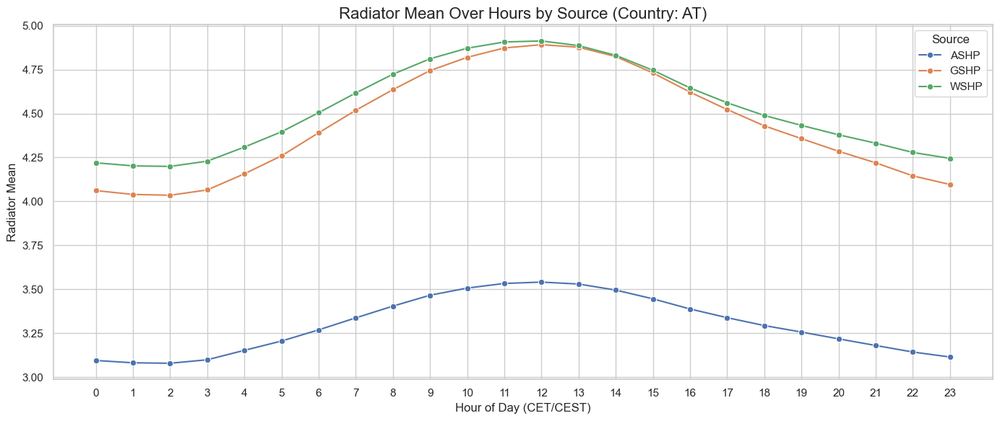

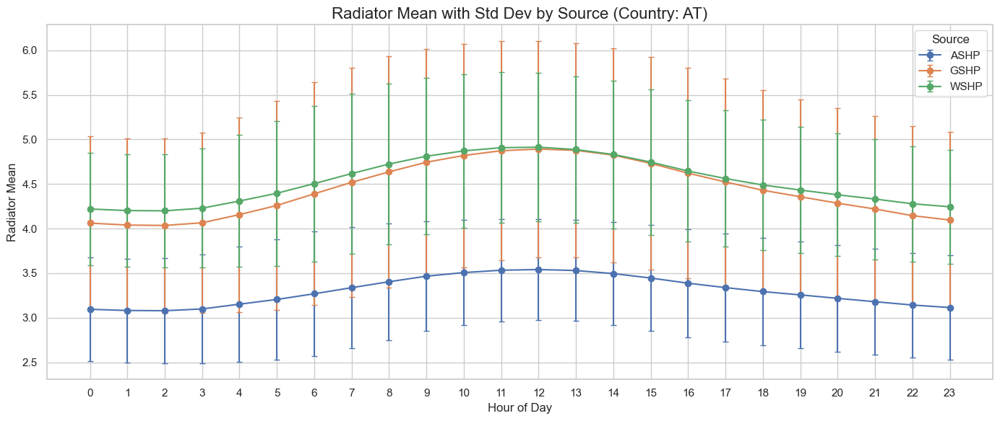

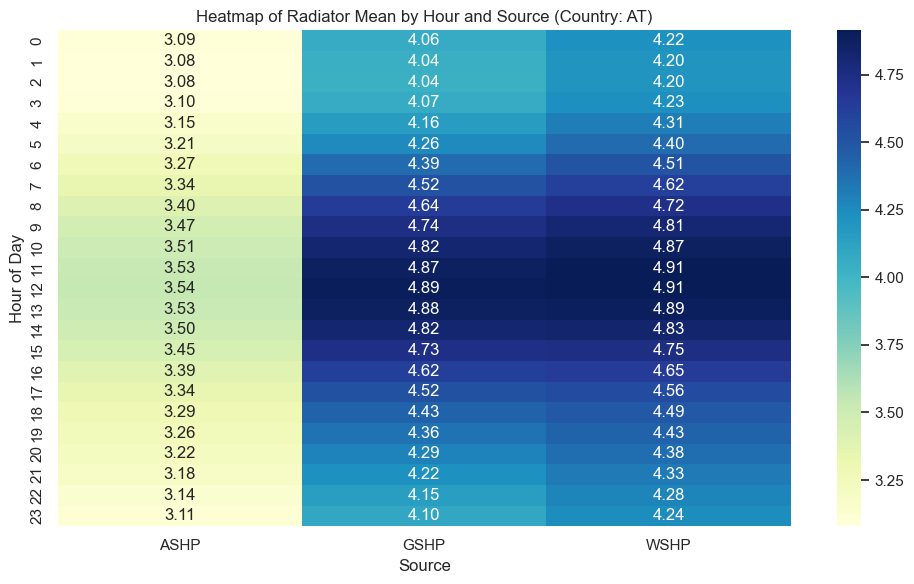

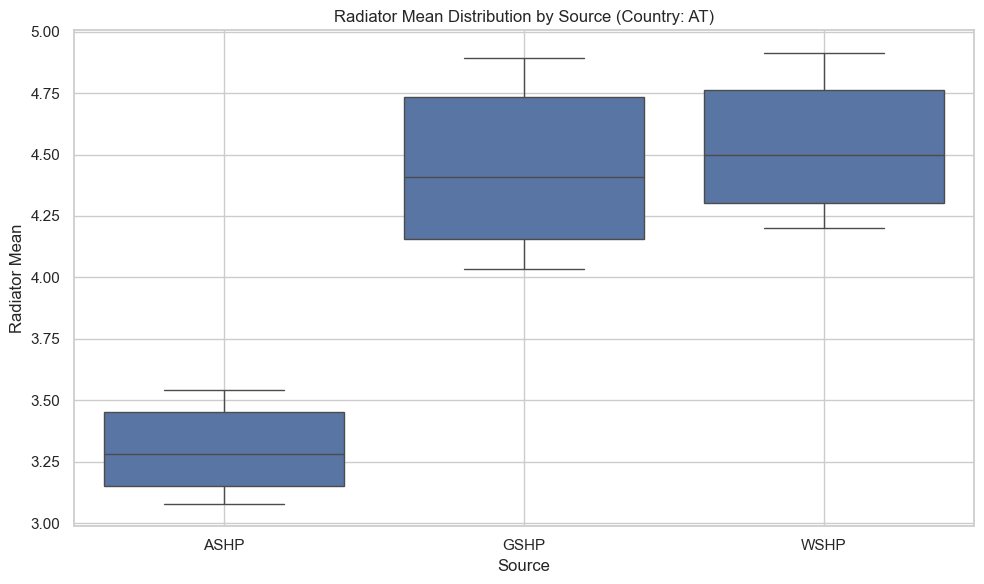

In [ ]:
# Using Filter data for the country (e.g., 'AT')
country_filter = 'AT'
df_plot_radiator = radiator_summary[radiator_summary['country'] == country_filter]

# Seting Seaborn theme
sns.set_theme(style="whitegrid")

# Creating a line plot of Radiator Mean vs Hour, with a line for each Source
plt.figure(figsize=(14, 6))
sns.lineplot(
    data=df_plot_radiator,
    x='hour',
    y='Radiator_Mean',
    hue='source',
    marker='o'
)

plt.title(f'Radiator Mean Over Hours by Source (Country: {country_filter})', fontsize=16)
plt.xlabel('Hour of Day (CET/CEST)', fontsize=12)
plt.ylabel('Radiator Mean', fontsize=12)
plt.xticks(range(0, 24))
plt.legend(title='Source')
plt.grid(True)
plt.tight_layout()
plt.show()



# Creating a plot with error bars for Radiator Mean and Std Dev by Source
plt.figure(figsize=(14, 6))

for source in df_plot_radiator['source'].unique():
    data_source = df_plot_radiator[df_plot_radiator['source'] == source]
    plt.errorbar(
        data_source['hour'],
        data_source['Radiator_Mean'],
        yerr=data_source['Radiator_Std'],
        label=source,
        marker='o',
        capsize=3
    )

plt.title(f'Radiator Mean with Std Dev by Source (Country: {country_filter})', fontsize=16)
plt.xlabel('Hour of Day', fontsize=12)
plt.ylabel('Radiator Mean', fontsize=12)
plt.legend(title='Source')
plt.xticks(range(0, 24))
plt.grid(True)
plt.tight_layout()
plt.show()



# Using Pivot the dataframe for the heatmap
pivot_df_radiator = radiator_summary[radiator_summary['country'] == country_filter].pivot(
    index='hour',
    columns='source',
    values='Radiator_Mean'
)

# For Creating the heatmap
plt.figure(figsize=(10, 6))
sns.heatmap(pivot_df_radiator, annot=True, fmt=".2f", cmap="YlGnBu")
plt.title(f'Heatmap of Radiator Mean by Hour and Source (Country: {country_filter})')
plt.ylabel('Hour of Day')
plt.xlabel('Source')
plt.tight_layout()
plt.show()



# Creating a boxplot for the distribution of Radiator Mean by Source
plt.figure(figsize=(10, 6))
sns.boxplot(
    data=radiator_summary[radiator_summary['country'] == country_filter],
    x='source',
    y='Radiator_Mean'
)
plt.title(f'Radiator Mean Distribution by Source (Country: {country_filter})')
plt.xlabel('Source')
plt.ylabel('Radiator Mean')
plt.grid(True)
plt.tight_layout()
plt.show()


In [ ]:
# Converting timestamp to datetime and extract ISO week
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['iso_week'] = df['cet_cest_timestamp'].dt.isocalendar().week

# Grouping by country, week (ignoring year), and source — compute radiator statistics
weekly_radiator_summary = df.groupby(['country', 'iso_week', 'source']).agg(
    Radiator_Mean=('radiator', 'mean'),
    Radiator_Std=('radiator', 'std'),
    Radiator_Min=('radiator', 'min'),
    Radiator_Median=('radiator', 'median'),
    Radiator_25=('radiator', lambda x: x.quantile(0.25)),
    Radiator_75=('radiator', lambda x: x.quantile(0.75)),
    Radiator_Max=('radiator', 'max')
).reset_index()


def render_weekly_radiator_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Week</th>
                    <th>Source</th>
                    <th>Radiator Mean</th>
                    <th>Radiator Std</th>
                    <th>Radiator Min</th>
                    <th>Radiator Median</th>
                    <th>Radiator 25%</th>
                    <th>Radiator 75%</th>
                    <th>Radiator Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_week = None
    for _, row in df.iterrows():
        # Adding a separator row when the week changes
        if last_week is not None and row['iso_week'] != last_week:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each week group
        country_display = ""  
        if row['iso_week'] != last_week:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{row['iso_week']}</td>
            <td>{row['source']}</td>
            <td>{row['Radiator_Mean']:.3f}</td>
            <td>{row['Radiator_Std']:.4f}</td>
            <td>{row['Radiator_Min']}</td>
            <td>{row['Radiator_Median']}</td>
            <td>{row['Radiator_25']}</td>
            <td>{row['Radiator_75']}</td>
            <td>{row['Radiator_Max']}</td>
        </tr>
        """
        last_week = row['iso_week']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html


# Generating the styled HTML table for the weekly radiator summary
styled_weekly_radiator_summary_table = render_weekly_radiator_summary_table(weekly_radiator_summary)
display(HTML(styled_weekly_radiator_summary_table))


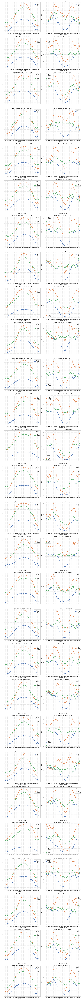

In [ ]:
# Assuming your weekly_radiator_summary dataframe is called `weekly_radiator_summary`
countries = weekly_radiator_summary['country'].unique()

# Using For Set style
sns.set(style="whitegrid")

# Using For Number of subplots (one per country)
n_countries = len(countries)

# Creating a figure with subplots: 2 rows, number of countries columns
fig, axes = plt.subplots(n_countries, 2, figsize=(14, 6 * n_countries))

# If only one country, axes will be a single 1D array, so we need to handle that
if n_countries == 1:
    axes = axes.reshape(1, 2)

# Looping over each country to create a subplot
for i, country in enumerate(countries):
    country_data = weekly_radiator_summary[weekly_radiator_summary['country'] == country]
    
    # Ploting Radiator Mean (left column)
    sns.lineplot(data=country_data, x='iso_week', y='Radiator_Mean', hue='source', marker='o', ax=axes[i, 0])
    axes[i, 0].set_title(f'Weekly Radiator Mean by Source ({country})', fontsize=14)
    axes[i, 0].set_xlabel('ISO Week Number')
    axes[i, 0].set_ylabel('Radiator Mean')
    axes[i, 0].set_xticks(range(1, 53))  # one tick per week
    axes[i, 0].grid(True, linestyle='--', alpha=0.5)
    axes[i, 0].legend(title='Source')

    # For Ploting Radiator Std (right column)
    sns.lineplot(data=country_data, x='iso_week', y='Radiator_Std', hue='source', marker='o', ax=axes[i, 1])
    axes[i, 1].set_title(f'Weekly Radiator Std by Source ({country})', fontsize=14)
    axes[i, 1].set_xlabel('ISO Week Number')
    axes[i, 1].set_ylabel('Radiator Std')
    axes[i, 1].set_xticks(range(1, 53))  # one tick per week
    axes[i, 1].grid(True, linestyle='--', alpha=0.5)
    axes[i, 1].legend(title='Source')

# For Adjusting layout to prevent overlapping
plt.tight_layout()   
plt.show()


In [ ]:
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['month'] = df['cet_cest_timestamp'].dt.month

# Grouping by country, month, and source — compute radiator statistics
monthly_radiator_summary = df.groupby(['country', 'month', 'source']).agg(
    Radiator_Mean=('radiator', 'mean'),
    Radiator_Std=('radiator', 'std'),
    Radiator_Min=('radiator', 'min'),
    Radiator_Median=('radiator', 'median'),
    Radiator_25=('radiator', lambda x: x.quantile(0.25)),
    Radiator_75=('radiator', lambda x: x.quantile(0.75)),
    Radiator_Max=('radiator', 'max')
).reset_index()

def render_monthly_radiator_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Month</th>
                    <th>Source</th>
                    <th>Radiator Mean</th>
                    <th>Radiator Std</th>
                    <th>Radiator Min</th>
                    <th>Radiator Median</th>
                    <th>Radiator 25%</th>
                    <th>Radiator 75%</th>
                    <th>Radiator Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_month = None
    for _, row in df.iterrows():
        # Adding a separator row when the month changes
        if last_month is not None and row['month'] != last_month:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each month group
        country_display = ""  
        if row['month'] != last_month:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{row['month']}</td>
            <td>{row['source']}</td>
            <td>{row['Radiator_Mean']:.3f}</td>
            <td>{row['Radiator_Std']:.4f}</td>
            <td>{row['Radiator_Min']}</td>
            <td>{row['Radiator_Median']}</td>
            <td>{row['Radiator_25']}</td>
            <td>{row['Radiator_75']}</td>
            <td>{row['Radiator_Max']}</td>
        </tr>
        """
        last_month = row['month']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html


# Assuming `monthly_radiator_summary` dataframe is already available
styled_monthly_radiator_summary_table = render_monthly_radiator_summary_table(monthly_radiator_summary.head(30))
display(HTML(styled_monthly_radiator_summary_table))

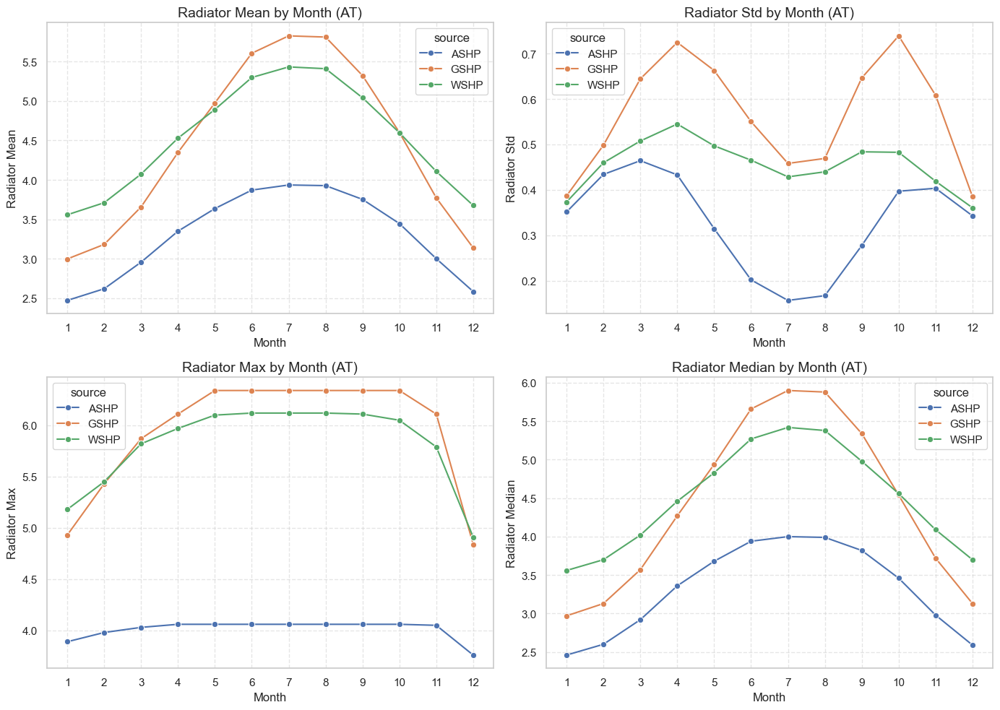

In [ ]:
at_monthly = monthly_radiator_summary[monthly_radiator_summary['country'] == 'AT']

# Setting the style for plots
sns.set(style="whitegrid")

# Creating a figure with multiple subplots for each metric (Radiator Mean, Radiator Std, Radiator Max)
fig, axs = plt.subplots(2, 2, figsize=(14, 10))

# Ploting Radiator Mean over Month
sns.lineplot(data=at_monthly, x='month', y='Radiator_Mean', hue='source', marker='o', ax=axs[0, 0])
axs[0, 0].set_title('Radiator Mean by Month (AT)', fontsize=14)
axs[0, 0].set_xlabel('Month')
axs[0, 0].set_ylabel('Radiator Mean')
axs[0, 0].set_xticks(range(1, 13))  # Months 1 to 12
axs[0, 0].grid(True, linestyle='--', alpha=0.5)

# Ploting Radiator Std over Month
sns.lineplot(data=at_monthly, x='month', y='Radiator_Std', hue='source', marker='o', ax=axs[0, 1])
axs[0, 1].set_title('Radiator Std by Month (AT)', fontsize=14)
axs[0, 1].set_xlabel('Month')
axs[0, 1].set_ylabel('Radiator Std')
axs[0, 1].set_xticks(range(1, 13))  # Months 1 to 12
axs[0, 1].grid(True, linestyle='--', alpha=0.5)

# Ploting Radiator Max over Month
sns.lineplot(data=at_monthly, x='month', y='Radiator_Max', hue='source', marker='o', ax=axs[1, 0])
axs[1, 0].set_title('Radiator Max by Month (AT)', fontsize=14)
axs[1, 0].set_xlabel('Month')
axs[1, 0].set_ylabel('Radiator Max')
axs[1, 0].set_xticks(range(1, 13))  # Months 1 to 12
axs[1, 0].grid(True, linestyle='--', alpha=0.5)

# Ploting Radiator Median over Month
sns.lineplot(data=at_monthly, x='month', y='Radiator_Median', hue='source', marker='o', ax=axs[1, 1])
axs[1, 1].set_title('Radiator Median by Month (AT)', fontsize=14)
axs[1, 1].set_xlabel('Month')
axs[1, 1].set_ylabel('Radiator Median')
axs[1, 1].set_xticks(range(1, 13))  # Months 1 to 12
axs[1, 1].grid(True, linestyle='--', alpha=0.5)

# For Adjusting layout to avoid overlap
plt.tight_layout()
plt.show()


In [ ]:
# Extracting Year from the timestamp
df['year'] = df['cet_cest_timestamp'].dt.year

# Grouping by country, year, and source — compute radiator statistics
yearly_radiator_summary = df.groupby(['country', 'year', 'source']).agg(
    Radiator_Mean=('radiator', 'mean'),
    Radiator_Std=('radiator', 'std'),
    Radiator_Min=('radiator', 'min'),
    Radiator_Median=('radiator', 'median'),
    Radiator_25=('radiator', lambda x: x.quantile(0.25)),
    Radiator_75=('radiator', lambda x: x.quantile(0.75)),
    Radiator_Max=('radiator', 'max')
).reset_index()

# Rendering a styled HTML table for yearly radiator summary
def render_yearly_radiator_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Year</th>
                    <th>Source</th>
                    <th>Radiator Mean</th>
                    <th>Radiator Std</th>
                    <th>Radiator Min</th>
                    <th>Radiator Median</th>
                    <th>Radiator 25%</th>
                    <th>Radiator 75%</th>
                    <th>Radiator Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_year = None
    for _, row in df.iterrows():
        # Adding a separator row when the year changes
        if last_year is not None and row['year'] != last_year:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each year group
        country_display = ""  
        if row['year'] != last_year:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{row['year']}</td>
            <td>{row['source']}</td>
            <td>{row['Radiator_Mean']:.3f}</td>
            <td>{row['Radiator_Std']:.4f}</td>
            <td>{row['Radiator_Min']}</td>
            <td>{row['Radiator_Median']}</td>
            <td>{row['Radiator_25']}</td>
            <td>{row['Radiator_75']}</td>
            <td>{row['Radiator_Max']}</td>
        </tr>
        """
        last_year = row['year']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html

# Assuming `yearly_radiator_summary` dataframe is already available
styled_yearly_summary_table = render_yearly_radiator_summary_table(yearly_radiator_summary.head(20))
display(HTML(styled_yearly_summary_table))


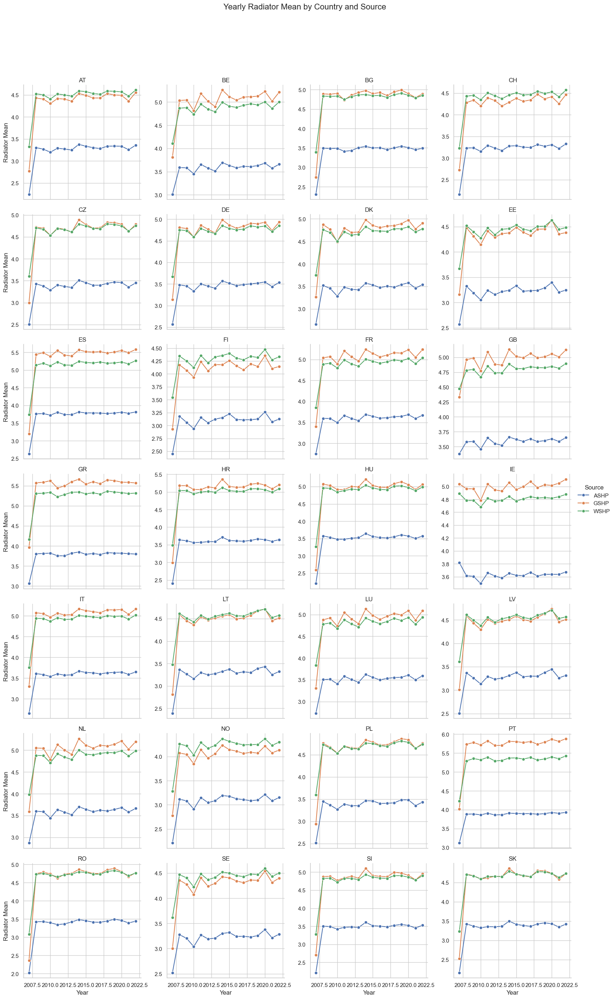

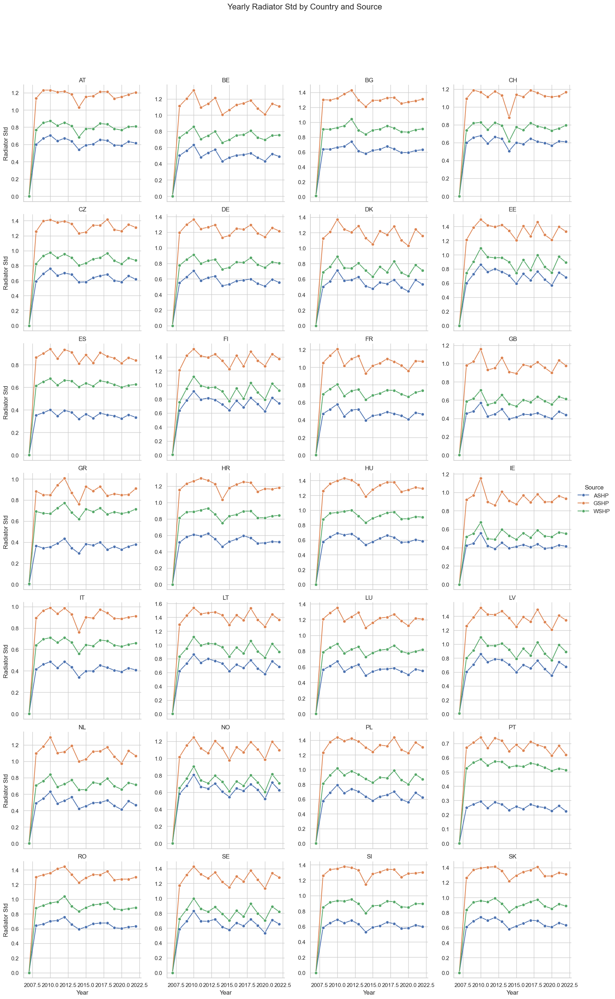

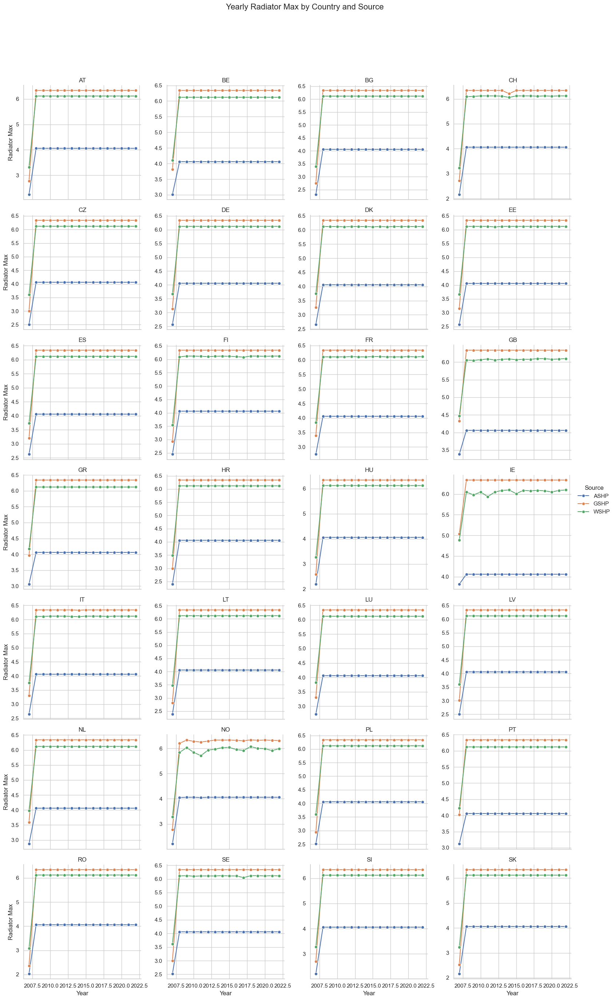

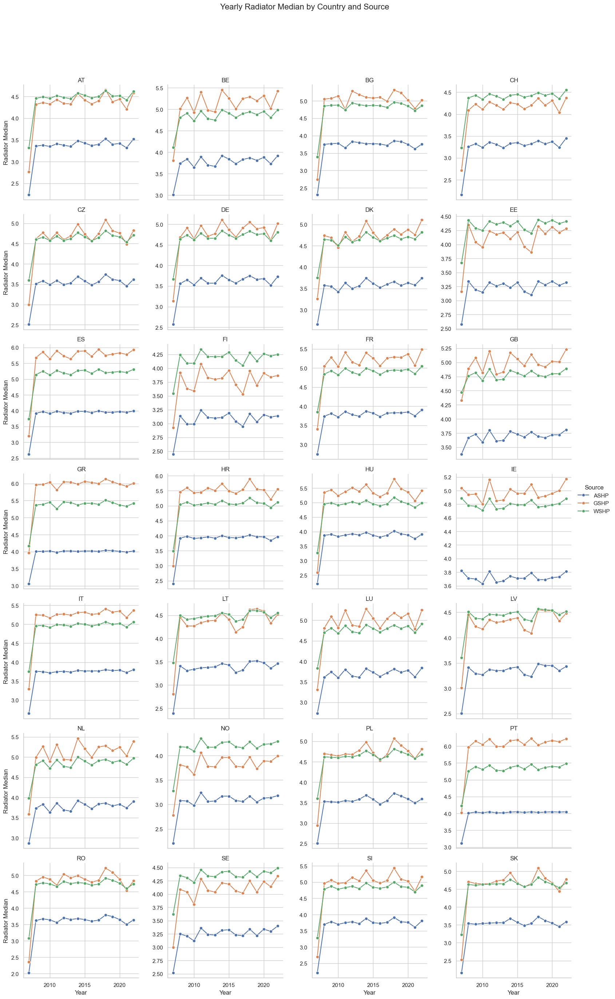

In [ ]:
# Setting up the FacetGrid for Radiator Mean
g = sns.FacetGrid(yearly_radiator_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Radiator Mean)
g.map_dataframe(sns.lineplot, x="year", y="Radiator_Mean", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Radiator Mean")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Radiator Mean by Country and Source", fontsize=16)

plt.show()

# Setting up the FacetGrid for Radiator Std
g = sns.FacetGrid(yearly_radiator_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Radiator Std)
g.map_dataframe(sns.lineplot, x="year", y="Radiator_Std", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Radiator Std")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Radiator Std by Country and Source", fontsize=16)

plt.show()

# Setting up the FacetGrid for Radiator Max
g = sns.FacetGrid(yearly_radiator_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Radiator Max)
g.map_dataframe(sns.lineplot, x="year", y="Radiator_Max", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Radiator Max")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Radiator Max by Country and Source", fontsize=16)

plt.show()

# Setting up the FacetGrid for Radiator Median
g = sns.FacetGrid(yearly_radiator_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Radiator Median)
g.map_dataframe(sns.lineplot, x="year", y="Radiator_Median", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Radiator Median")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Radiator Median by Country and Source", fontsize=16)

plt.show()


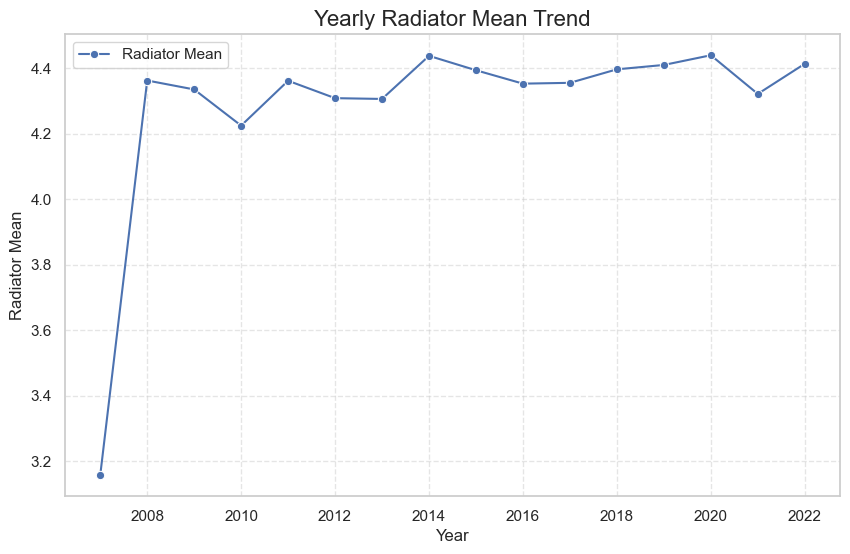

In [ ]:
# Converting the timestamp to datetime and extract the year
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['year'] = df['cet_cest_timestamp'].dt.year

# Step 2: Grouping the data by year and calculate mean radiator usage for each year
yearly_radiator_trend = df.groupby('year').agg(
    Radiator_Mean=('radiator', 'mean'),
    Radiator_Std=('radiator', 'std'),
    Radiator_Min=('radiator', 'min'),
    Radiator_Median=('radiator', 'median'),
    Radiator_Max=('radiator', 'max')
).reset_index()

# Step 3: Ploting the yearly radiator trend (Radiator Mean)
plt.figure(figsize=(10, 6))
sns.lineplot(data=yearly_radiator_trend, x='year', y='Radiator_Mean', marker='o', label='Radiator Mean')

# Adding titles and labels
plt.title('Yearly Radiator Mean Trend', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Radiator Mean', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)

# Showing plot
plt.show()


In [ ]:
# Extracting Year from the timestamp
df['year'] = df['cet_cest_timestamp'].dt.year

# Grouping by country, year, and source — compute floor statistics
yearly_floor_summary = df.groupby(['country', 'year', 'source']).agg(
    Floor_Mean=('floor', 'mean'),
    Floor_Std=('floor', 'std'),
    Floor_Min=('floor', 'min'),
    Floor_Median=('floor', 'median'),
    Floor_25=('floor', lambda x: x.quantile(0.25)),
    Floor_75=('floor', lambda x: x.quantile(0.75)),
    Floor_Max=('floor', 'max')
).reset_index()

# Rendering a styled HTML table for yearly floor summary
def render_yearly_floor_summary_table(df):
    html = """
    <div style="font-family: Arial, sans-serif; background-color: #f9f9f9; padding: 20px; border-radius: 10px;">
        <table style="width: 100%; border-collapse: collapse; margin-top: 20px; font-size: 14px; text-align: center; border: 1px solid #ddd;">
            <thead style="background-color: #4CAF50; color: white; font-weight: bold;">
                <tr>
                    <th>Country</th>
                    <th>Year</th>
                    <th>Source</th>
                    <th>Floor Mean</th>
                    <th>Floor Std</th>
                    <th>Floor Min</th>
                    <th>Floor Median</th>
                    <th>Floor 25%</th>
                    <th>Floor 75%</th>
                    <th>Floor Max</th>
                </tr>
            </thead>
            <tbody style="background-color: #ffffff;">
    """

    last_year = None
    for _, row in df.iterrows():
        # Adding a separator row when the year changes
        if last_year is not None and row['year'] != last_year:
            html += '<tr style="height: 2px; background-color: #e0e0e0;"><td colspan="10"></td></tr>'

        # Displaying country only on the second row of each year group
        country_display = ""  
        if row['year'] != last_year:
            country_display = row['country']

        html += f"""
        <tr>
            <td>{country_display}</td>
            <td>{row['year']}</td>
            <td>{row['source']}</td>
            <td>{row['Floor_Mean']:.3f}</td>
            <td>{row['Floor_Std']:.4f}</td>
            <td>{row['Floor_Min']}</td>
            <td>{row['Floor_Median']}</td>
            <td>{row['Floor_25']}</td>
            <td>{row['Floor_75']}</td>
            <td>{row['Floor_Max']}</td>
        </tr>
        """
        last_year = row['year']

    html += """
            </tbody>
        </table>
    </div>
    """
    return html

# Assuming `yearly_floor_summary` dataframe is already available
styled_yearly_summary_table = render_yearly_floor_summary_table(yearly_floor_summary.head(20))
display(HTML(styled_yearly_summary_table))

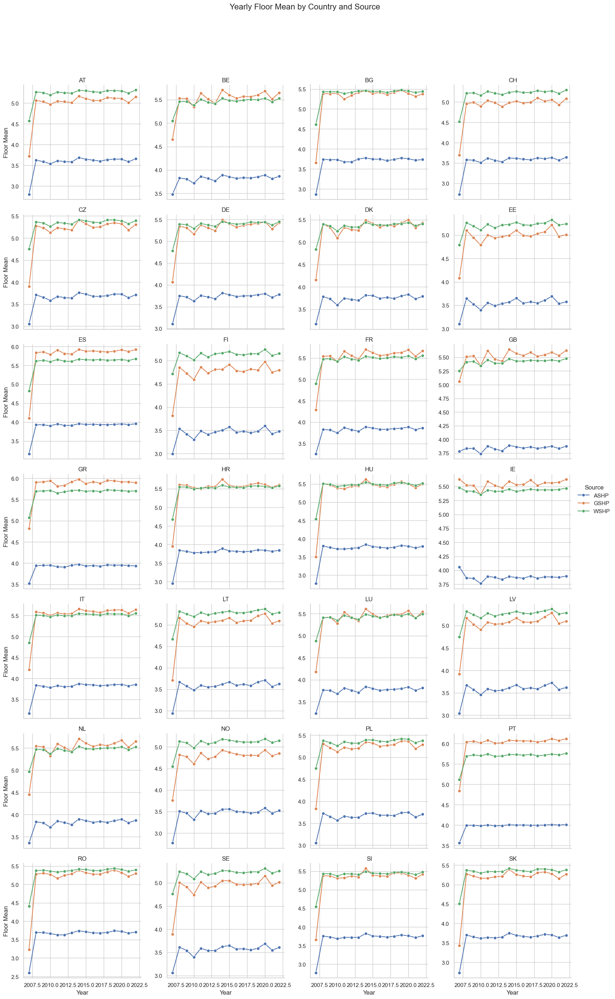

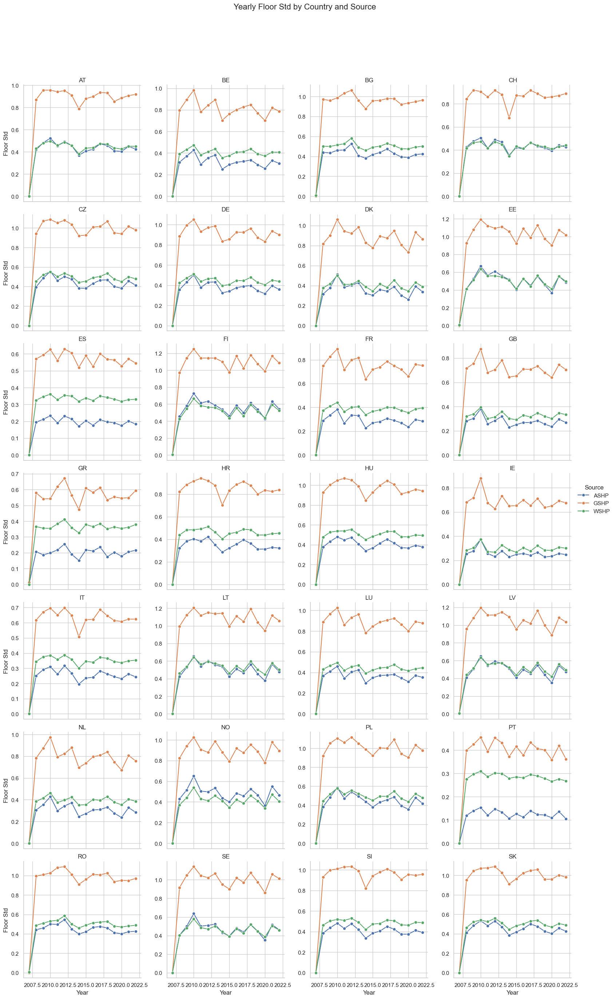

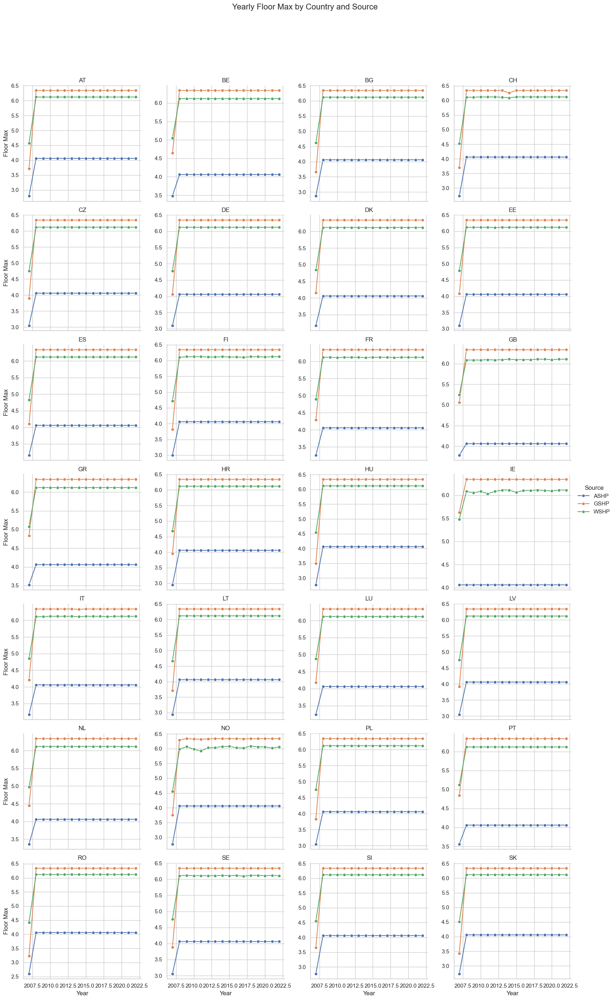

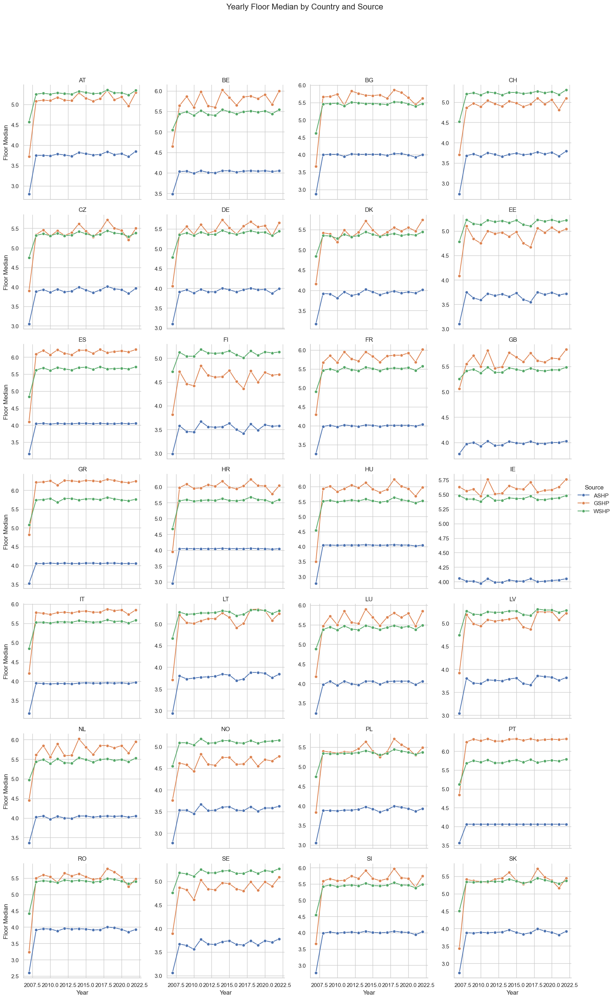

In [ ]:
# Setting up the FacetGrid for Floor Mean
g = sns.FacetGrid(yearly_floor_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Floor Mean)
g.map_dataframe(sns.lineplot, x="year", y="Floor_Mean", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Floor Mean")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Floor Mean by Country and Source", fontsize=16)

plt.show()

# Setting up the FacetGrid for Floor Std
g = sns.FacetGrid(yearly_floor_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Floor Std)
g.map_dataframe(sns.lineplot, x="year", y="Floor_Std", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Floor Std")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Floor Std by Country and Source", fontsize=16)

plt.show()

# Seting up the FacetGrid for Floor Max
g = sns.FacetGrid(yearly_floor_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Floor Max)
g.map_dataframe(sns.lineplot, x="year", y="Floor_Max", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Floor Max")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Floor Max by Country and Source", fontsize=16)

plt.show()

# Seting up the FacetGrid for Floor Median
g = sns.FacetGrid(yearly_floor_summary, col="country", col_wrap=4, height=4, sharey=False)

# Maping lineplots to each facet (Floor Median)
g.map_dataframe(sns.lineplot, x="year", y="Floor_Median", hue="source", marker='o')

# Adding titles and labels
g.add_legend(title="Source")
g.set_axis_labels("Year", "Floor Median")
g.set_titles(col_template="{col_name}")
g.fig.subplots_adjust(top=0.9)
g.fig.suptitle("Yearly Floor Median by Country and Source", fontsize=16)

plt.show()


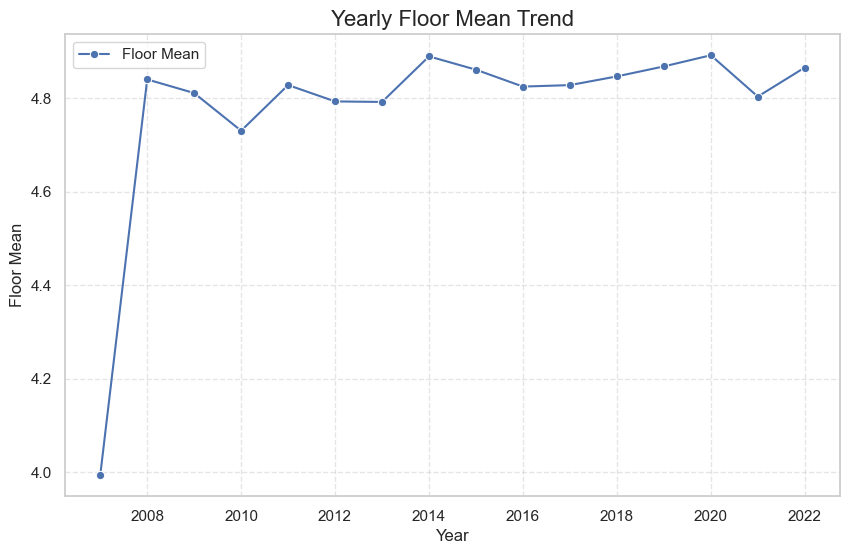

In [ ]:
# Converting the timestamp to datetime and extract the year
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)
df['year'] = df['cet_cest_timestamp'].dt.year

# Step 2: Grouping the data by year and calculate mean floor usage for each year
yearly_floor_trend = df.groupby('year').agg(
    Floor_Mean=('floor', 'mean'),
    Floor_Std=('floor', 'std'),
    Floor_Min=('floor', 'min'),
    Floor_Median=('floor', 'median'),
    Floor_Max=('floor', 'max')
).reset_index()

# Step 3: Ploting the yearly floor trend (Floor Mean)
plt.figure(figsize=(10, 6))
sns.lineplot(data=yearly_floor_trend, x='year', y='Floor_Mean', marker='o', label='Floor Mean')

# Adding titles and labels
plt.title('Yearly Floor Mean Trend', fontsize=16)
plt.xlabel('Year', fontsize=12)
plt.ylabel('Floor Mean', fontsize=12)
plt.grid(True, linestyle='--', alpha=0.5)

# Showing plot
plt.show()


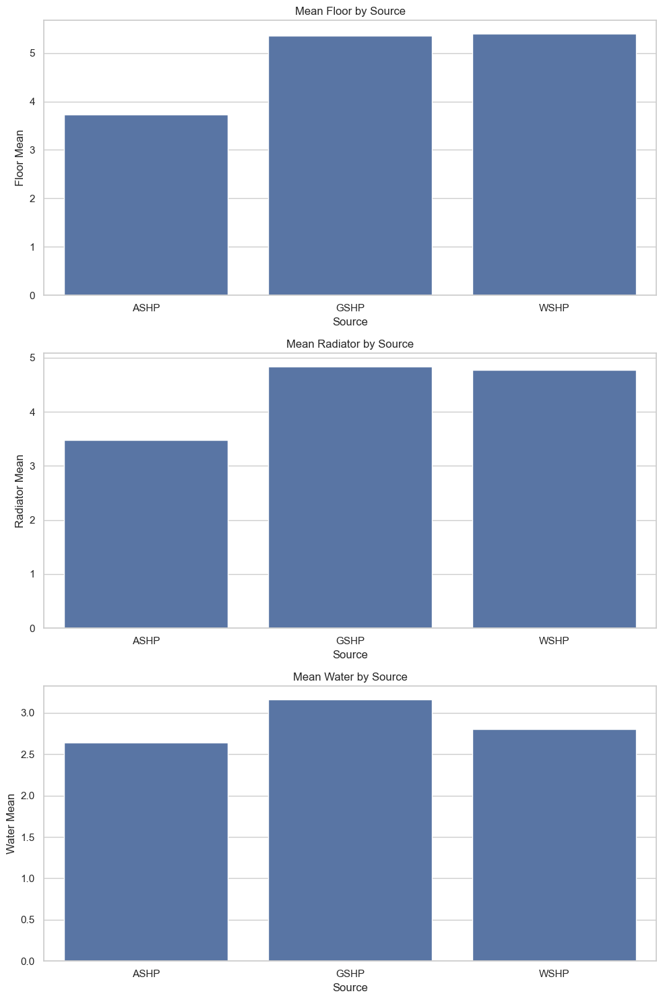

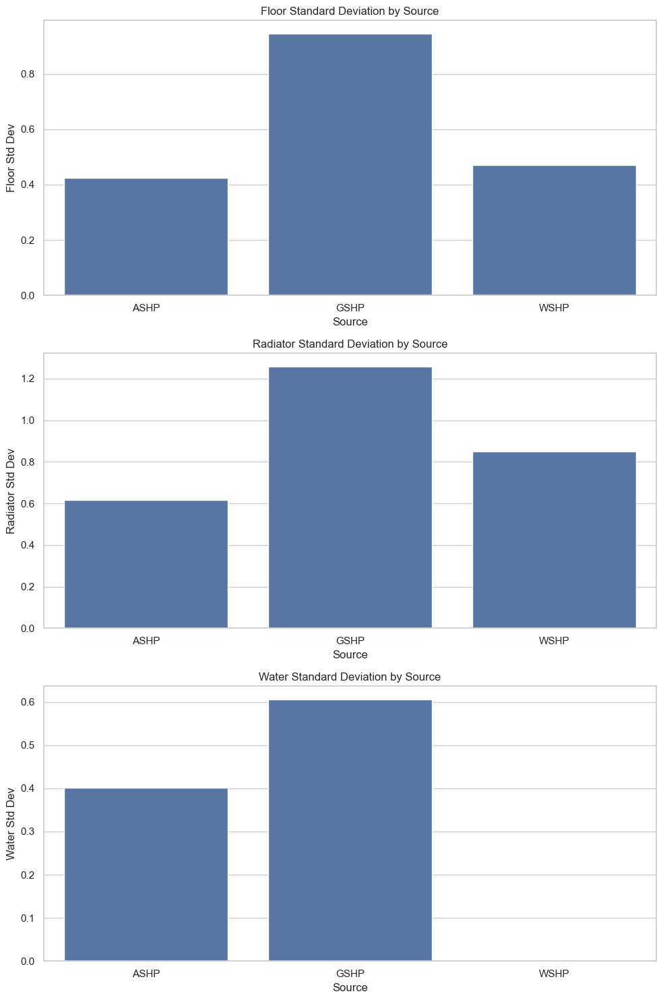

In [ ]:
df['cet_cest_timestamp'] = pd.to_datetime(df['cet_cest_timestamp'], utc=True)

# Grouping by source and compute the statistics for floor, radiator, and water
source_summary = df.groupby('source').agg(
    Floor_Mean=('floor', 'mean'),
    Floor_Std=('floor', 'std'),
    Floor_Min=('floor', 'min'),
    Floor_Median=('floor', 'median'),
    Floor_Max=('floor', 'max'),
    
    Radiator_Mean=('radiator', 'mean'),
    Radiator_Std=('radiator', 'std'),
    Radiator_Min=('radiator', 'min'),
    Radiator_Median=('radiator', 'median'),
    Radiator_Max=('radiator', 'max'),
    
    Water_Mean=('water', 'mean'),
    Water_Std=('water', 'std'),
    Water_Min=('water', 'min'),
    Water_Median=('water', 'median'),
    Water_Max=('water', 'max')
).reset_index()


sns.set(style="whitegrid")

# Ploting mean values for floor, radiator, and water based on the source
fig, axs = plt.subplots(3, 1, figsize=(10, 15))

sns.barplot(data=source_summary, x='source', y='Floor_Mean', ax=axs[0])
axs[0].set_title('Mean Floor by Source')
axs[0].set_xlabel('Source')
axs[0].set_ylabel('Floor Mean')

sns.barplot(data=source_summary, x='source', y='Radiator_Mean', ax=axs[1])
axs[1].set_title('Mean Radiator by Source')
axs[1].set_xlabel('Source')
axs[1].set_ylabel('Radiator Mean')

sns.barplot(data=source_summary, x='source', y='Water_Mean', ax=axs[2])
axs[2].set_title('Mean Water by Source')
axs[2].set_xlabel('Source')
axs[2].set_ylabel('Water Mean')

plt.tight_layout()
plt.show()

fig, axs = plt.subplots(3, 1, figsize=(10, 15))

sns.barplot(data=source_summary, x='source', y='Floor_Std', ax=axs[0])
axs[0].set_title('Floor Standard Deviation by Source')
axs[0].set_xlabel('Source')
axs[0].set_ylabel('Floor Std Dev')

sns.barplot(data=source_summary, x='source', y='Radiator_Std', ax=axs[1])
axs[1].set_title('Radiator Standard Deviation by Source')
axs[1].set_xlabel('Source')
axs[1].set_ylabel('Radiator Std Dev')

sns.barplot(data=source_summary, x='source', y='Water_Std', ax=axs[2])
axs[2].set_title('Water Standard Deviation by Source')
axs[2].set_xlabel('Source')
axs[2].set_ylabel('Water Std Dev')

plt.tight_layout()
plt.show()